In [ ]:
# Start writing code here...

In [ ]:
import sys
sys.path.append('..')

import os
import pickle

import numpy as np
import pandas as pd

from lib.viz import chart_feature_target_relation, create_correlation_scatters, get_feature_target_correlation, create_feature_target_heatmap


from lib.viz import draw_missing_data_chart, draw_corr_heatmap, draw_components_variance_chart
from lib.read_data import read_feature_files, read_and_join_output_file, combine_datasets

%matplotlib inline


/shared-libs/python3.9/py/lib/python3.9/site-packages/geopandas/_compat.py:111: UserWarning: The Shapely GEOS version (3.10.2-CAPI-1.16.0) is incompatible with the GEOS version PyGEOS was compiled with (3.10.1-CAPI-1.16.0). Conversions between both will be slow.
  warnings.warn(


### Study the Feature to Target Variable Relationship

In [ ]:
dir_path = "../assets/train_test_standardscaler/"
with open(f'{dir_path}train_test_dict_standardscaler.pickle', 'rb') as file:
        train_test_dict = pickle.load( file)
X_train_impute = train_test_dict['X_train_impute']
X_test_impute = train_test_dict['X_test_impute']
y_train = train_test_dict['y_train']
y_test = train_test_dict['y_test']

with open(f'{dir_path}X_train_impute_standardscaler_df.pkl', 'rb') as file:
        X_train_impute_df = pickle.load( file)
with open(f'{dir_path}X_test_impute_standardscaler_df.pkl', 'rb') as file:
        X_test_impute_df = pickle.load( file)

train_with_target_df = combine_datasets(X_train_impute_df, y_train)
test_with_target_df = combine_datasets(X_test_impute_df, y_test)
full_df = train_with_target_df.append(test_with_target_df)
full_df.set_index(['TOWNSHIP_RANGE', 'YEAR'], inplace=True)

Text(0.5, 1.0, 'Features Correlating with GSE_GWE')

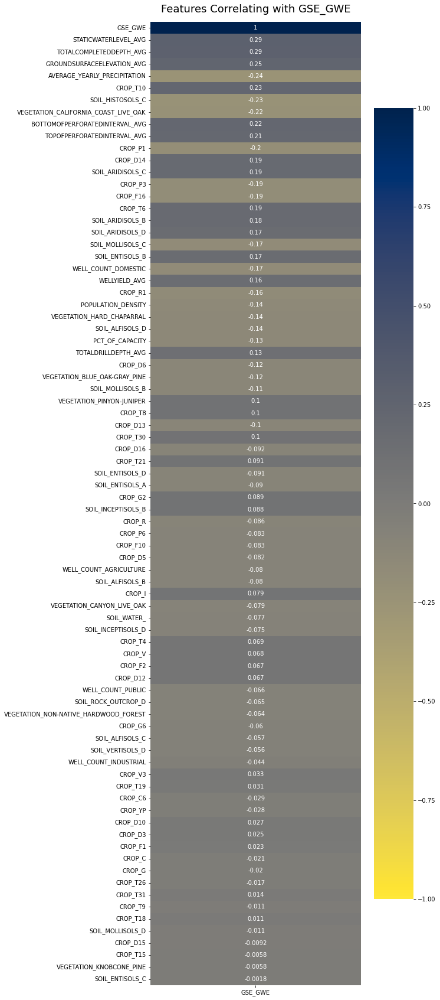

In [ ]:
create_feature_target_heatmap(full_df, target='GSE_GWE', sort_by_absolute=True)

### Feature to target correlation observation

NOTE: the correlation values are below 0.3. This indicates a very **low correlation of features with target in general**. The below is a discussion of relative correlation of features with target.

The target is related highly to well features in a township_range such as its completed depth and water level in the well. It is also influenced by the ground surface elevation of the township range. It is negatively correlated to the precipitation as might be expected since more precipitation will result in less depth at which groudwater can be found.

Orions and Garlic (T10) and "alfalfa & alfalfa mixtures (P1) and Pistachios (D14) are also correlated with target more than other crops.

Text(0.5, 1.0, 'Features Correlating with GSE_GWE')

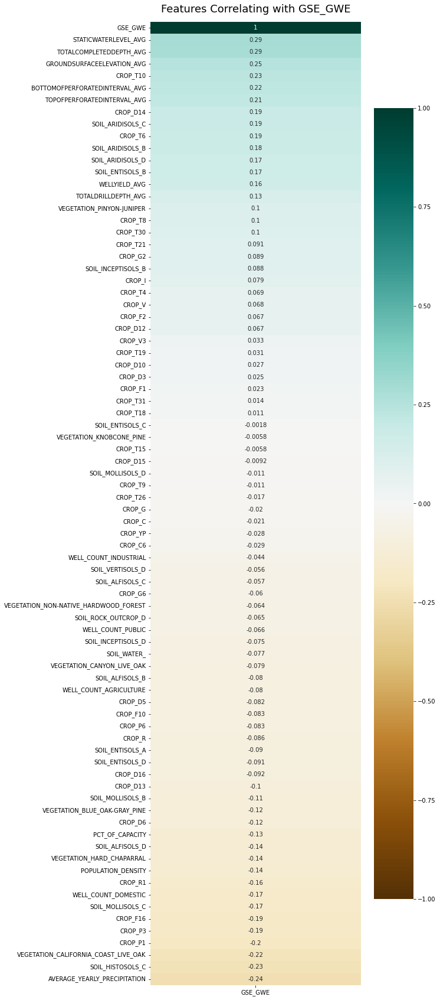

In [ ]:
create_feature_target_heatmap(full_df, target='GSE_GWE', sort_by_absolute=False)

In [ ]:
draw_corr_heatmap(full_df.reset_index(), ['TOWNSHIP_RANGE', 'YEAR'])

alt.Chart(...)

##### Groundwater levels

- Observed below: a dip in the groundwater levels from 2014 through 2016, the drought years, 
- then an increase until 2020 and followed by a drop in 2021, another sever drought year.

In [ ]:
for variable in [col for col in  X_train_impute_df.columns if col.startswith('WELL_')]:
    display(chart_feature_target_relation( X_train_impute_df, y_train, variable))

alt.LayerChart(...)

alt.LayerChart(...)

alt.LayerChart(...)

alt.LayerChart(...)

##### Wells
Agriculture (-0.167) and Domestic (-0.083) wells show the most variance and negative correlation to target.

In [ ]:
for variable in [col for col in  X_train_impute_df.columns if col.startswith('VEGETATION_')]:
    display(chart_feature_target_relation( X_train_impute_df, y_train, variable))

alt.LayerChart(...)

alt.LayerChart(...)

alt.LayerChart(...)

alt.LayerChart(...)

alt.LayerChart(...)

alt.LayerChart(...)

alt.LayerChart(...)

#### Vegetation

Vegetations CALIFORNIA_COAST_LIVE_OAK, PINYON_JUMPER, HARD_CHAPARAL show high correlation number in relation to the target but the data is sparse. Whereas VEGETATION_NON-NATIVE_HARDWOOD_FOREST does not indicate highly correlation co-efficient but the data is better distributed.

In [ ]:
for variable in [col for col in  X_train_impute_df.columns if col.startswith('SOIL_')]:
    display(chart_feature_target_relation( X_train_impute_df, y_train, variable))

alt.LayerChart(...)

alt.LayerChart(...)

alt.LayerChart(...)

alt.LayerChart(...)

alt.LayerChart(...)

alt.LayerChart(...)

alt.LayerChart(...)

alt.LayerChart(...)

alt.LayerChart(...)

alt.LayerChart(...)

alt.LayerChart(...)

alt.LayerChart(...)

alt.LayerChart(...)

alt.LayerChart(...)

alt.LayerChart(...)

alt.LayerChart(...)

alt.LayerChart(...)

alt.LayerChart(...)

alt.LayerChart(...)

In [ ]:
for variable in [col for col in X_train_impute_df if not col.startswith(('VEGETATION', 'SOIL', 'CROP', 'WELL'))]:
    display(chart_feature_target_relation( X_train_impute_df, y_train, variable))

alt.LayerChart(...)

alt.LayerChart(...)

alt.LayerChart(...)

alt.LayerChart(...)

alt.LayerChart(...)

alt.LayerChart(...)

alt.LayerChart(...)

alt.LayerChart(...)

alt.LayerChart(...)

In [ ]:
display(get_feature_target_correlation(X_train_impute_df, y_train, 'GSE_GWE'))

,Correlation_Coefficient
GSE_GWE,1.000000
GROUNDSURFACEELEVATION_AVG,0.327728
STATICWATERLEVEL_AVG,0.288546
TOTALCOMPLETEDDEPTH_AVG,0.277842
SOIL_HISTOSOLS_C,-0.244215
...,...
CROP_T31,-0.013296
CROP_T9,-0.012354
CROP_T15,-0.011686
CROP_D15,-0.005005


### Correlation of test features with target


In [ ]:
display(get_feature_target_correlation(X_test_impute_df, y_test, 'GSE_GWE'))

,Correlation_Coefficient
GSE_GWE,1.000000
AVERAGE_YEARLY_PRECIPITATION,-0.438165
TOTALCOMPLETEDDEPTH_AVG,0.346239
TOTALDRILLDEPTH_AVG,0.341984
STATICWATERLEVEL_AVG,0.327932
...,...
SOIL_VERTISOLS_D,NaN
SOIL_WATER_,NaN
CROP_G,NaN
CROP_R,NaN


In [ ]:
for variable in [col for col in X_test_impute_df if not col.startswith(('VEGETATION', 'SOIL', 'CROP', 'WELL'))]:
    display(chart_feature_target_relation( X_test_impute_df, y_test, variable))

alt.LayerChart(...)

alt.LayerChart(...)

alt.LayerChart(...)

alt.LayerChart(...)

alt.LayerChart(...)

alt.LayerChart(...)

alt.LayerChart(...)

alt.LayerChart(...)

alt.LayerChart(...)

<a style='text-decoration:none;line-height:16px;display:flex;color:#5B5B62;padding:10px;justify-content:end;' href='https://deepnote.com?utm_source=created-in-deepnote-cell&projectId=b042e2da-6536-449d-95b8-d85fa08825de' target="_blank">
 </img>
Created in <span style='font-weight:600;margin-left:4px;'>Deepnote</span></a>